In [ ]:

import requests
import pandas as pd

# Define the API endpoint
url = "https://api.pokemontcg.io/v2/sets"

# Send the request to the API
response = requests.get(url)

# Parse the JSON response
sets = response.json()

# Create a list to store the set information
sets_list = []

# Display the available sets
for set in sets['data']:
    sets_list.append({
        "Set Name": set['name'],
        "Set Code": set['id'],
        "Release Date": set['releaseDate']
    })

# Convert the list to a DataFrame
sets_df = pd.DataFrame(sets_list)

# Print the DataFrame
print(sets_df)

                      Set Name Set Code Release Date
0                         Base    base1   1999/01/09
1                       Jungle    base2   1999/06/16
2    Wizards Black Star Promos    basep   1999/07/01
3                       Fossil    base3   1999/10/10
4                   Base Set 2    base4   2000/02/24
..                         ...      ...          ...
155                        151   sv3pt5   2023/09/22
156               Paradox Rift      sv4   2023/11/03
157              Paldean Fates   sv4pt5   2024/01/26
158            Temporal Forces      sv5   2024/03/22
159        Twilight Masquerade      sv6   2024/05/24

[160 rows x 3 columns]


In [45]:

import requests
import pandas as pd

# Define the deck dictionary
deck = {
    "Hisuian Growlithe": {"set": "TWM", "number": 181, "quantity": 4},
    "Hisuian Arcanine": {"set": "TWM", "number": 100, "quantity": 4},
    "Munkidori": {"set": "TWM", "number": 95, "quantity": 3},
    "Snorunt": {"set": "PAF", "number": 188, "quantity": 3},
    "Froslass": {"set": "TWM", "number": 174, "quantity": 3},
    "Cleffa": {"set": "OBF", "number": 202, "quantity": 1},
    "Irida": {"set": "ASR", "number": 186, "quantity": 1},
    "Iscan": {"set": "LOR", "number": 192, "quantity": 4},
    "Lana's Aid": {"set": "TWM", "number": 207, "quantity": 1},
    "Iono": {"set": "PAL", "number": 254, "quantity": 2},
    "Hyper Aroma": {"set": "TWM", "number": 152, "quantity": 1},
    "Counter Catcher": {"set": "PAR", "number": 264, "quantity": 1},
    "Artazon": {"set": "OBF", "number": 229, "quantity": 3},
    "Boss's Orders": {"set": "PAL", "number": 248, "quantity": 2},
    "Colress's Experiment": {"set": "LOR", "number": 190, "quantity": 4},
    "Super Rod": {"set": "PAL", "number": 276, "quantity": 1},
    "Buddy-Buddy Poffin": {"set": "TEF", "number": 144, "quantity": 4},
    "Switch": {"set": "SVI", "number": 194, "quantity": 2},
    "Earthen Vessel": {"set": "PAR", "number": 163, "quantity": 2},
    "Pokégear 3.0": {"set": "SVI", "number": 233, "quantity": 3},
    "Nest Ball": {"set": "SV1", "number": 255, "quantity": 3},
    "Ultra Ball": {"set": "PAF", "number": 186, "quantity": 3},
    "Basic {D} Energy": {"set": "Energy", "number": 15, "quantity": 5},
}

# Define the API endpoint
api_url = "https://api.pokemontcg.io/v2/cards"

# Create a list to store detailed card information
detailed_deck_list = []

# Traverse the deck dictionary and fetch card details from the API
for card_name, card_info in deck.items():
    # Construct the search query
    query = f"name:\"{card_name}\" number:{card_info['number']}"
    params = {"q": query}

    # Send the request to the API
    response = requests.get(api_url, params=params)
    if response.status_code == 200:
        card_data = response.json()
        if card_data['data']:
            card_details = card_data['data'][0]
            detailed_deck_list.append({
                "Card Name": card_name,
                "Quantity": card_info['quantity'],
                #"price_30d_n" : card_details['tcgplayer']['prices']['normal']['market'],
                "price_30d_h" : card_details['tcgplayer']['prices'],#['holofoil']['market'],
                "Set": card_info['set'],
                "Set_name": card_details['set']['name'],
                "Set_id": card_details['set']['id'],
                "Number": card_info['number'],
                "Image URL": card_details['images']['large'],
                "Supertype": card_details['supertype'],
                "subtypes": card_details['subtypes'],
                "HP": card_details.get('hp', 'N/A'),
                "Attacks": [attack['name'] for attack in card_details.get('attacks', [])],
                "legal_unl": card_details['legalities']['unlimited'],
                "legal_std": card_details['legalities']['standard']
            })

# Convert the list to a DataFrame
detailed_deck_df = pd.DataFrame(detailed_deck_list)

# Print the DataFrame
detailed_deck_df

,Card Name,Quantity,price_30d_h,Set,Set_name,Set_id,Number,Image URL,Supertype,subtypes,HP,Attacks,legal_unl,legal_std
0,Hisuian Growlithe,4,"{'holofoil': {'low': 5.35, 'mid': 10.53, 'high...",TWM,Twilight Masquerade,sv6,181,https://images.pokemontcg.io/sv6/181_hires.png,Pokémon,[Basic],80,"[Blazing Destruction, Take Down]",Legal,Legal
1,Hisuian Arcanine,4,"{'holofoil': {'low': 0.01, 'mid': 0.1, 'high':...",TWM,Twilight Masquerade,sv6,100,https://images.pokemontcg.io/sv6/100_hires.png,Pokémon,[Stage 1],130,"[Proud Fangs, Searing Flame]",Legal,Legal
2,Munkidori,3,"{'reverseHolofoil': {'low': 0.21, 'mid': 0.5, ...",TWM,Twilight Masquerade,sv6,95,https://images.pokemontcg.io/sv6/95_hires.png,Pokémon,[Basic],110,[Mind Bend],Legal,Legal
3,Snorunt,3,"{'holofoil': {'low': 2.99, 'mid': 5.0, 'high':...",PAF,Paradox Rift,sv4,188,https://images.pokemontcg.io/sv4/188_hires.png,Pokémon,[Basic],60,[Ice Shard],Legal,Legal
4,Froslass,3,"{'holofoil': {'low': 2.99, 'mid': 4.5, 'high':...",TWM,Twilight Masquerade,sv6,174,https://images.pokemontcg.io/sv6/174_hires.png,Pokémon,[Stage 1],90,[Frost Smash],Legal,Legal
5,Cleffa,1,"{'holofoil': {'low': 4.0, 'mid': 7.65, 'high':...",OBF,Obsidian Flames,sv3,202,https://images.pokemontcg.io/sv3/202_hires.png,Pokémon,[Basic],30,[Grasping Draw],Legal,Legal
6,Irida,1,"{'holofoil': {'low': 17.68, 'mid': 23.38, 'hig...",ASR,Astral Radiance,swsh10,186,https://images.pokemontcg.io/swsh10/186_hires.png,Trainer,[Supporter],N/A,[],Legal,Legal
7,Iscan,4,"{'holofoil': {'low': 0.69, 'mid': 1.13, 'high'...",LOR,Lost Origin,swsh11,192,https://images.pokemontcg.io/swsh11/192_hires.png,Trainer,[Supporter],N/A,[],Legal,Legal
8,Lana's Aid,1,"{'holofoil': {'low': 2.75, 'mid': 4.5, 'high':...",TWM,Twilight Masquerade,sv6,207,https://images.pokemontcg.io/sv6/207_hires.png,Trainer,[Supporter],N/A,[],Legal,Legal
9,Iono,2,"{'holofoil': {'low': 14.99, 'mid': 22.94, 'hig...",PAL,Paldea Evolved,sv2,254,https://images.pokemontcg.io/sv2/254_hires.png,Trainer,[Supporter],N/A,[],Legal,Legal


In [19]:
card_details

{'id': 'swsh11-83',
 'name': 'Hisuian Growlithe',
 'supertype': 'Pokémon',
 'subtypes': ['Basic'],
 'hp': '70',
 'types': ['Fighting'],
 'evolvesTo': ['Arcanine'],
 'attacks': [{'name': 'Singe',
   'cost': [],
   'convertedEnergyCost': 0,
   'damage': '',
   'text': "Your opponent's Active Pokémon is now Burned."}],
 'weaknesses': [{'type': 'Grass', 'value': '×2'}],
 'retreatCost': ['Colorless', 'Colorless'],
 'convertedRetreatCost': 2,
 'set': {'id': 'swsh11',
  'name': 'Lost Origin',
  'series': 'Sword & Shield',
  'printedTotal': 196,
  'total': 217,
  'legalities': {'unlimited': 'Legal',
   'standard': 'Legal',
   'expanded': 'Legal'},
  'ptcgoCode': 'LOR',
  'releaseDate': '2022/09/09',
  'updatedAt': '2022/09/09 13:45:00',
  'images': {'symbol': 'https://images.pokemontcg.io/swsh11/symbol.png',
   'logo': 'https://images.pokemontcg.io/swsh11/logo.png'}},
 'number': '83',
 'artist': 'Kouki Saitou',
 'rarity': 'Common',
 'flavorText': 'They patrol their territory in pairs. I believ

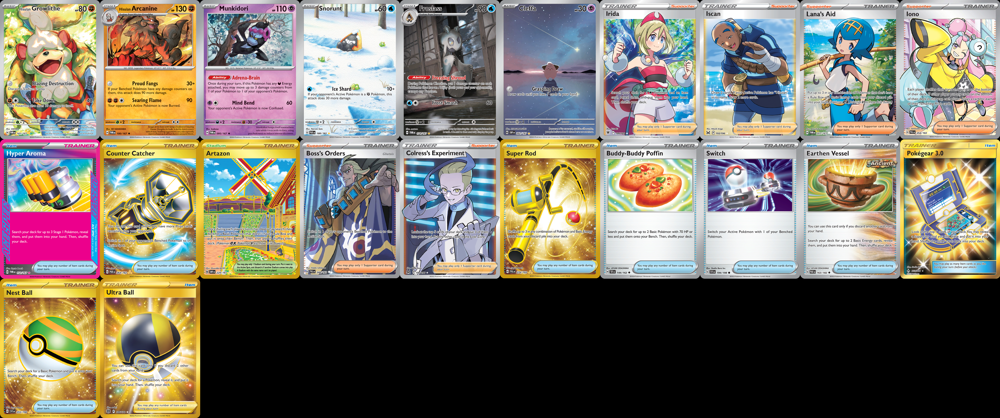

In [46]:
import requests
import pandas as pd
from PIL import Image
from io import BytesIO

# Define the API endpoint
api_url = "https://api.pokemontcg.io/v2/cards"

# Create a list to store the image URLs
image_urls = []

# Traverse the deck dictionary and fetch card details from the API
for card_name, card_info in deck.items():
    # Construct the search query
    query = f"name:\"{card_name}\" number:{card_info['number']}"
    params = {"q": query}

    # Send the request to the API
    response = requests.get(api_url, params=params)
    if response.status_code == 200:
        card_data = response.json()
        if card_data['data']:
            card_details = card_data['data'][0]
            image_urls.append(card_details['images']['large'])

# Function to combine images into a single image
def combine_images(image_urls, images_per_row=10):
    images = [Image.open(BytesIO(requests.get(url).content)) for url in image_urls]
    widths, heights = zip(*(img.size for img in images))
    total_width = sum(widths[:images_per_row])
    max_height = max(heights) * ((len(images) + images_per_row - 1) // images_per_row)

    combined_image = Image.new('RGB', (total_width, max_height))

    x_offset = 0
    y_offset = 0
    for i, img in enumerate(images):
        if i % images_per_row == 0 and i != 0:
            x_offset = 0
            y_offset += max(heights)
        combined_image.paste(img, (x_offset, y_offset))
        x_offset += img.width

    return combined_image

# Combine images into a single image
combined_image = combine_images(image_urls)

# Save or display the combined image
combined_image.save('combined_deck_image.jpg')
combined_image

In [3]:

from scipy.stats import hypergeom
import pandas as pd


# The number of cards left in the deck after setting aside the prize cards
total_cards = 60
prize_cards = 6
cards_left_in_deck = total_cards - prize_cards  # 54 cards
hand_size = 7

# Function to calculate the combined probability considering the prize cards and the first hand drawing
def combined_probability(card_quantity, total_cards, prize_cards, hand_size):
    probabilities = []
    # Calculate the probability for each possible number of copies in the prize cards
    for k in range(0, min(card_quantity, prize_cards) + 1):
        # Probability that k copies are in the prize cards
        prob_k_in_prizes = hypergeom.pmf(k, total_cards, card_quantity, prize_cards)
        # Probability of drawing at least one copy from the remaining card_quantity - k copies
        remaining_copies = card_quantity - k
        if remaining_copies > 0:
            prob_at_least_one = 1 - hypergeom.cdf(0, cards_left_in_deck, remaining_copies, hand_size)
        else:
            prob_at_least_one = 0
        # Combine the probabilities
        combined_prob = prob_k_in_prizes * prob_at_least_one
        probabilities.append(combined_prob)
    # Sum all combined probabilities
    total_probability = sum(probabilities)
    return total_probability

# Calculate the probabilities for each card in the deck
probabilities = [
    {"Card Name": card,
     "Probability": combined_probability(details["quantity"], total_cards, prize_cards, hand_size)}
    for card, details in deck.items()
]

# Convert the list of dictionaries to a DataFrame
probabilities_df = pd.DataFrame(probabilities)

# Print the DataFrame
print(probabilities_df)

               Card Name  Probability
0      Hisuian Growlithe     0.399500
1              Munkidori     0.315430
2       Hisuian Arcanine     0.399500
3                Snorunt     0.315430
4               Froslass     0.315430
5                 Cleffa     0.116667
6        Counter Catcher     0.116667
7              Nest Ball     0.315430
8                  Irida     0.116667
9             Ultra Ball     0.315430
10          Pokégear 3.0     0.315430
11                 Iscan     0.399500
12               Artazon     0.315430
13         Boss's Orders     0.221469
14           Hyper Aroma     0.116667
15            Lana's Aid     0.116667
16                  Iono     0.221469
17  Colress's Experiment     0.399500
18             Super Rod     0.116667
19    Buddy-Buddy Poffin     0.399500
20                Switch     0.221469
21        Earthen Vessel     0.221469
22      Basic {D} Energy     0.474562
